## Import

In [ ]:
import mne
import numpy as np
import scipy
import os
import math
from scipy import signal as sg
from matplotlib import pyplot as plt
from mne.preprocessing import ICA, create_ecg_epochs, create_eog_epochs

## Load Data

In [ ]:
directory_path = "D:/EEG RESEARCH DATA"
os.chdir(directory_path)

raw = mne.io.read_raw_brainvision("......")

# Reconstruct the original events from our Raw object
events, event_ids = mne.events_from_annotations(raw)

Extracting parameters from 20231019_B68_stroopv1/20231019_B68_stroopv1_0001.vhdr...
Setting channel info structure...
Used Annotations descriptions: ['New Segment/', 'Stimulus/S  1']


In [ ]:
montage = mne.channels.make_standard_montage('standard_1020')
raw.set_channel_types({'ECG':'ecg'})
raw.set_channel_types({'vEOG':'eog'})
raw.set_channel_types({'hEOG':'eog'})

<RawBrainVision | 20231019_B68_stroopv1_0001.eeg, 67 x 958600 (958.6 s), ~72 kB, data not loaded>

In [ ]:
raw.set_montage(montage)
#fig = raw.plot_sensors(show_names=True)

<RawBrainVision | 20231019_B68_stroopv1_0001.eeg, 67 x 958600 (958.6 s), ~98 kB, data not loaded>

### Segment Grouping

In [ ]:
fs = 1000

trg0 = events[9,0] #Experiment Begin 
trg1 = events[10,0] #Task Begin
trg2 = events[-2,0] #Task End
trg3 = events[-1,0] #Experiment End

tmin = trg0/fs
tmax = trg3/fs

# #Segment in Samples
# seg1 = trg1 - trg0
# seg2 = trg2 - trg0
# seg3 = trg3 - trg0

# #Segment in ms
# newseg1 = int(seg1/fs)
# newseg2 = int(seg2/fs)
# newseg3 = int(seg3/fs)

## EEG Analysis

In [ ]:
raw_temp = raw.copy().crop(tmin = tmin, tmax = tmax) #make a copy

In [ ]:
############################### Segment Grouping for EEG ###############################
#Segment in Samples
eeg_seg1 = trg1 - trg0
eeg_seg2 = trg2 - trg0
eeg_seg3 = trg3 - trg0

#Segment in ms
eeg_newseg1 = int(eeg_seg1/fs)
eeg_newseg2 = int(eeg_seg2/fs)
eeg_newseg3 = int(eeg_seg3/fs)
############################### Segment Grouping for EEG ###############################

### Using Concatenated EEG

### ICA 

In [ ]:
#Regular Expression = Search certain pattern
regexp = r"(ECG|vEOG|hEOG)"
artifact_picks = mne.pick_channels_regexp(raw_temp.ch_names, regexp=regexp)
# raw_temp.plot(order=artifact_picks, n_channels=len(artifact_picks), show_scrollbars=False)

##### Visualizing Artifact

Using EOG channels: vEOG, hEOG
EOG channel index for this subject is: [64 65]
Filtering the data to remove DC offset to help distinguish blinks from saccades
Setting up band-pass filter from 1 - 10 Hz

FIR filter parameters
---------------------
Designing a two-pass forward and reverse, zero-phase, non-causal bandpass filter:
- Windowed frequency-domain design (firwin2) method
- Hann window
- Lower passband edge: 1.00
- Lower transition bandwidth: 0.50 Hz (-12 dB cutoff frequency: 0.75 Hz)
- Upper passband edge: 10.00 Hz
- Upper transition bandwidth: 0.50 Hz (-12 dB cutoff frequency: 10.25 Hz)
- Filter length: 10000 samples (10.000 sec)

Now detecting blinks and generating corresponding events
Found 90 significant peaks
Number of EOG events detected: 90
Not setting metadata
90 matching events found
No baseline correction applied
Loading data for 90 events and 1001 original time points ...
1 bad epochs dropped
Applying baseline correction (mode: mean)
No projector specified for this dat

[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    0.0s finished


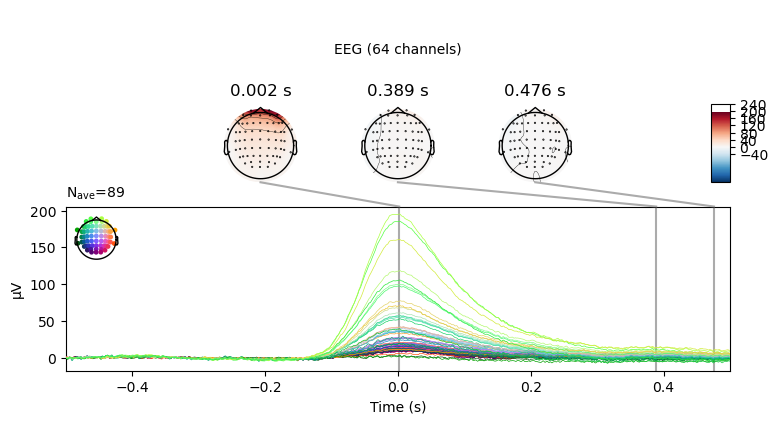

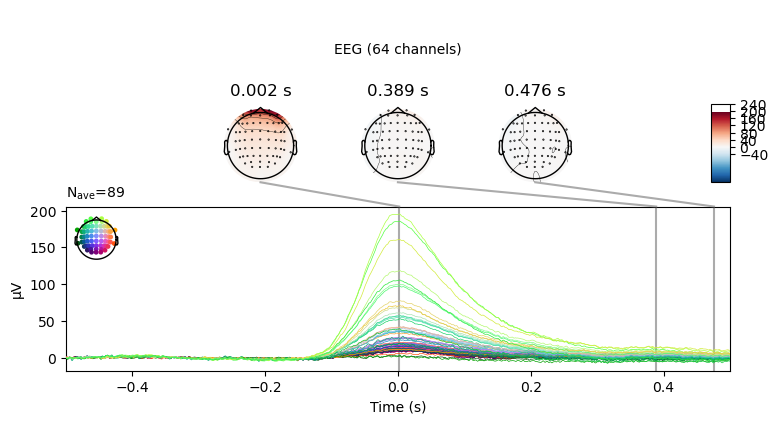

In [ ]:
eog_evoked = create_eog_epochs(raw_temp).average()
eog_evoked.apply_baseline(baseline=(None, -0.2))
eog_evoked.plot_joint()

Using channel ECG to identify heart beats.
Setting up band-pass filter from 8 - 16 Hz

FIR filter parameters
---------------------
Designing a two-pass forward and reverse, zero-phase, non-causal bandpass filter:
- Windowed frequency-domain design (firwin2) method
- Hann window
- Lower passband edge: 8.00
- Lower transition bandwidth: 0.50 Hz (-12 dB cutoff frequency: 7.75 Hz)
- Upper passband edge: 16.00 Hz
- Upper transition bandwidth: 0.50 Hz (-12 dB cutoff frequency: 16.25 Hz)
- Filter length: 10000 samples (10.000 sec)

Number of ECG events detected : 938 (average pulse 62 / min.)
Not setting metadata
938 matching events found
No baseline correction applied
Loading data for 938 events and 1001 original time points ...
1 bad epochs dropped
Applying baseline correction (mode: mean)
No projector specified for this dataset. Please consider the method self.add_proj.


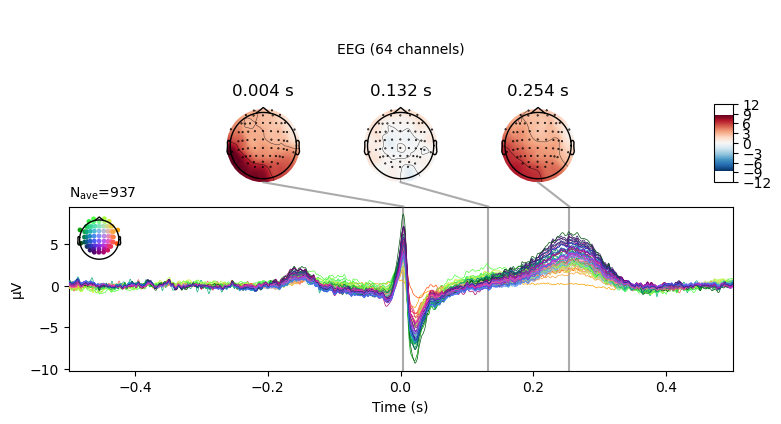

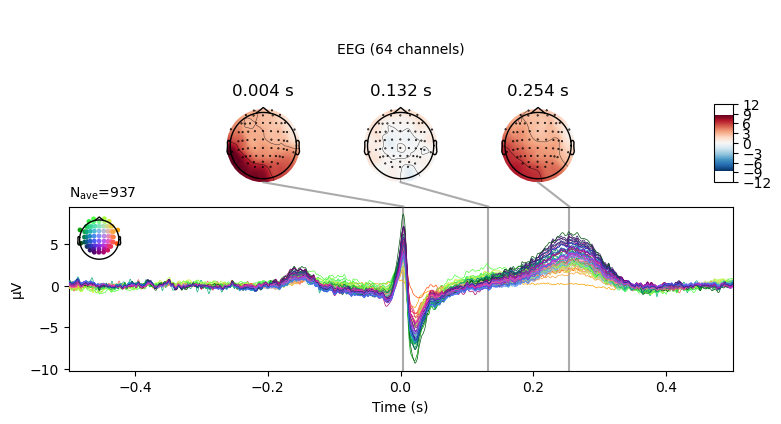

In [ ]:
ecg_evoked = create_ecg_epochs(raw_temp).average()
ecg_evoked.apply_baseline(baseline=(None, -0.2))
ecg_evoked.plot_joint()

##### Filtering to Remove Slow Drifts

In [ ]:
filt_raw = raw_temp.load_data().copy().filter(l_freq=1.0, h_freq=None)

Reading 0 ... 900501  =      0.000 ...   900.501 secs...
Filtering raw data in 1 contiguous segment
Setting up high-pass filter at 1 Hz

FIR filter parameters
---------------------
Designing a one-pass, zero-phase, non-causal highpass filter:
- Windowed time-domain design (firwin) method
- Hamming window with 0.0194 passband ripple and 53 dB stopband attenuation
- Lower passband edge: 1.00
- Lower transition bandwidth: 1.00 Hz (-6 dB cutoff frequency: 0.50 Hz)
- Filter length: 3301 samples (3.301 sec)



[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   2 out of   2 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   3 out of   3 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   4 out of   4 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done  64 out of  64 | elapsed:    1.6s finished


##### Extracting PCA

In [ ]:
ica = ICA(n_components=32, max_iter="auto", random_state = 95)
ica.fit(filt_raw)
ica

Fitting ICA to data using 64 channels (please be patient, this may take a while)
Selecting by number: 32 components
Fitting ICA took 49.2s.


Method,fastica
Fit,32 iterations on raw data (900502 samples)
ICA components,32
Available PCA components,64
Channel types,eeg
ICA components marked for exclusion,—


Creating RawArray with float64 data, n_channels=35, n_times=900502
    Range : 39471 ... 939972 =     39.471 ...   939.972 secs
Ready.
Using qt as 2D backend.
You set the browser-backend to "qt" but your current version 0.0.0 of mne-qt-browser is too low for ICA.Update with pip or conda.Defaults to matplotlib.
Using matplotlib as 2D backend.


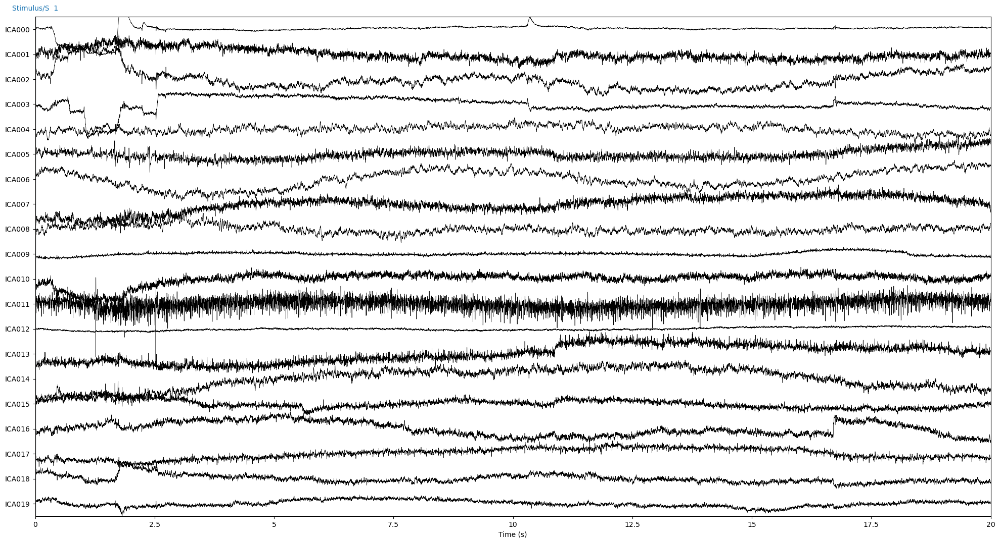

Using qt as 2D backend.


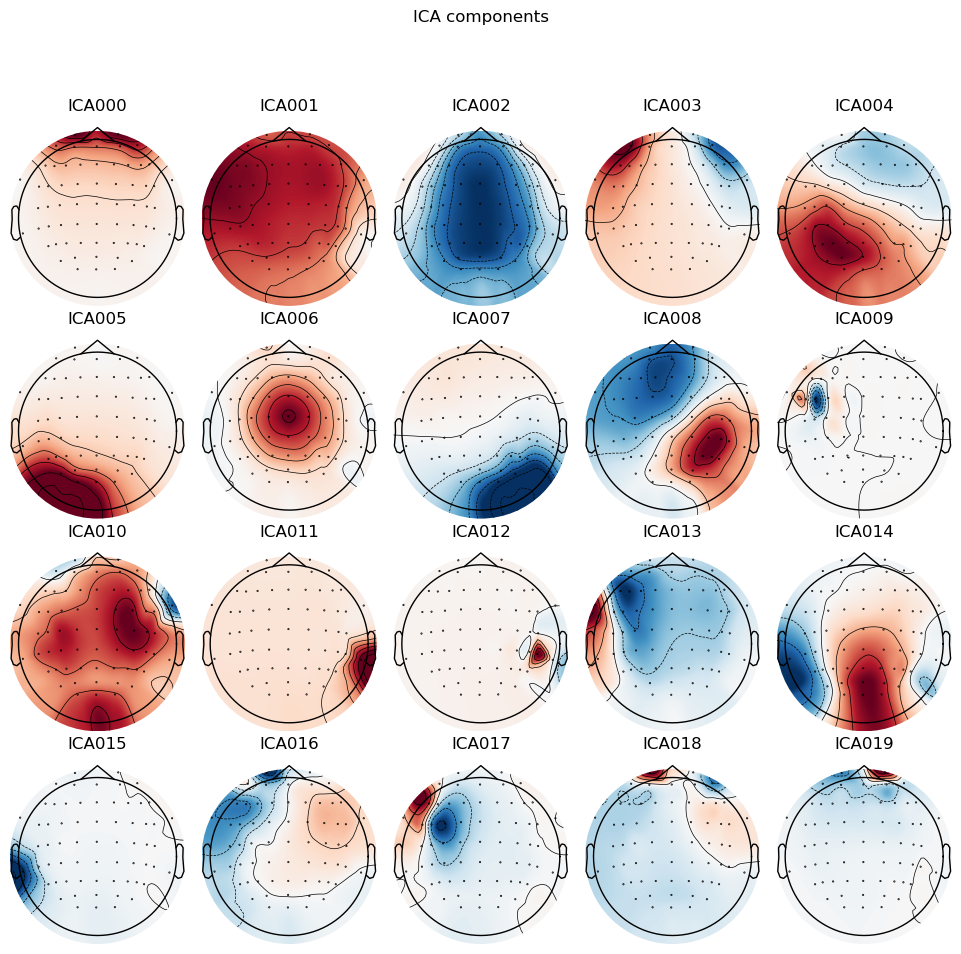

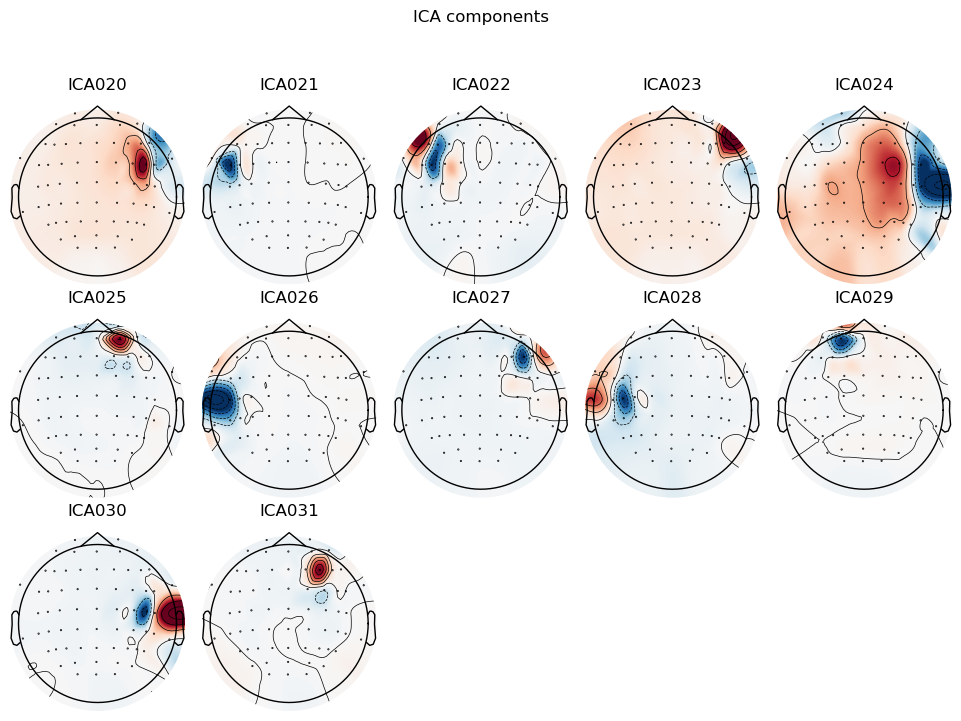

[<MNEFigure size 975x967 with 20 Axes>,
 <MNEFigure size 975x731.5 with 12 Axes>]

In [ ]:
ica.plot_sources(raw_temp, show_scrollbars=False)
ica.plot_components()

##### Check Blinks PCA

Using EOG channels: vEOG, hEOG
... filtering ICA sources
Setting up band-pass filter from 1 - 10 Hz

FIR filter parameters
---------------------
Designing a two-pass forward and reverse, zero-phase, non-causal bandpass filter:
- Windowed frequency-domain design (firwin2) method
- Hann window
- Lower passband edge: 1.00
- Lower transition bandwidth: 0.50 Hz (-12 dB cutoff frequency: 0.75 Hz)
- Upper passband edge: 10.00 Hz
- Upper transition bandwidth: 0.50 Hz (-12 dB cutoff frequency: 10.25 Hz)
- Filter length: 10000 samples (10.000 sec)



[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   2 out of   2 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   3 out of   3 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   4 out of   4 | elapsed:    0.1s remaining:    0.0s


... filtering target
Setting up band-pass filter from 1 - 10 Hz

FIR filter parameters
---------------------
Designing a two-pass forward and reverse, zero-phase, non-causal bandpass filter:
- Windowed frequency-domain design (firwin2) method
- Hann window
- Lower passband edge: 1.00
- Lower transition bandwidth: 0.50 Hz (-12 dB cutoff frequency: 0.75 Hz)
- Upper passband edge: 10.00 Hz
- Upper transition bandwidth: 0.50 Hz (-12 dB cutoff frequency: 10.25 Hz)
- Filter length: 10000 samples (10.000 sec)



[Parallel(n_jobs=1)]: Done  32 out of  32 | elapsed:    1.6s finished
[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    0.0s finished


... filtering ICA sources
Setting up band-pass filter from 1 - 10 Hz

FIR filter parameters
---------------------
Designing a two-pass forward and reverse, zero-phase, non-causal bandpass filter:
- Windowed frequency-domain design (firwin2) method
- Hann window
- Lower passband edge: 1.00
- Lower transition bandwidth: 0.50 Hz (-12 dB cutoff frequency: 0.75 Hz)
- Upper passband edge: 10.00 Hz
- Upper transition bandwidth: 0.50 Hz (-12 dB cutoff frequency: 10.25 Hz)
- Filter length: 10000 samples (10.000 sec)



[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   2 out of   2 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   3 out of   3 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   4 out of   4 | elapsed:    0.1s remaining:    0.0s


... filtering target
Setting up band-pass filter from 1 - 10 Hz

FIR filter parameters
---------------------
Designing a two-pass forward and reverse, zero-phase, non-causal bandpass filter:
- Windowed frequency-domain design (firwin2) method
- Hann window
- Lower passband edge: 1.00
- Lower transition bandwidth: 0.50 Hz (-12 dB cutoff frequency: 0.75 Hz)
- Upper passband edge: 10.00 Hz
- Upper transition bandwidth: 0.50 Hz (-12 dB cutoff frequency: 10.25 Hz)
- Filter length: 10000 samples (10.000 sec)



[Parallel(n_jobs=1)]: Done  32 out of  32 | elapsed:    1.5s finished
[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    0.0s finished


Applying ICA to Raw instance
    Transforming to ICA space (32 components)
    Zeroing out 2 ICA components
    Projecting back using 64 PCA components


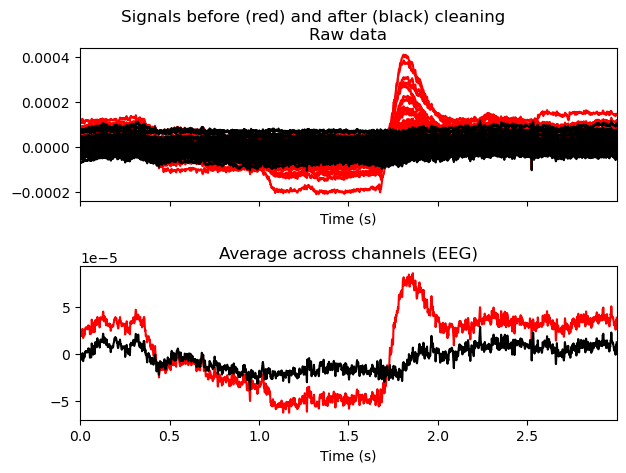

    Using multitaper spectrum estimation with 7 DPSS windows
Not setting metadata
450 matching events found
No baseline correction applied
0 projection items activated
Not setting metadata
450 matching events found
No baseline correction applied
0 projection items activated


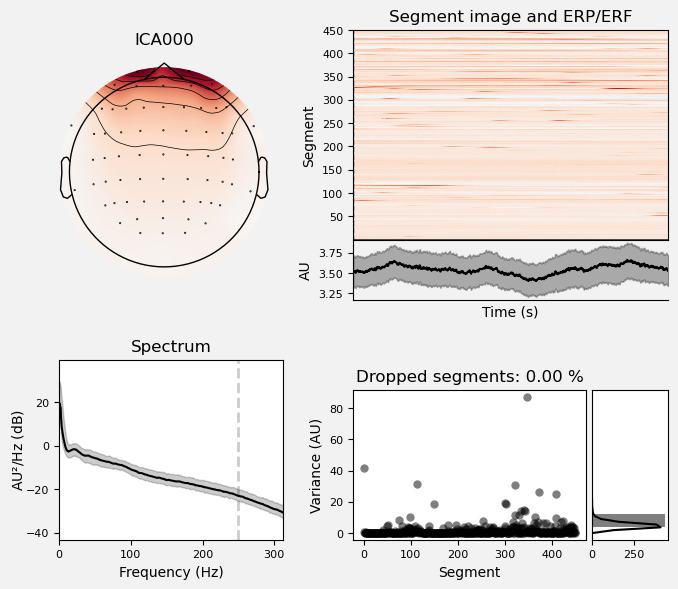

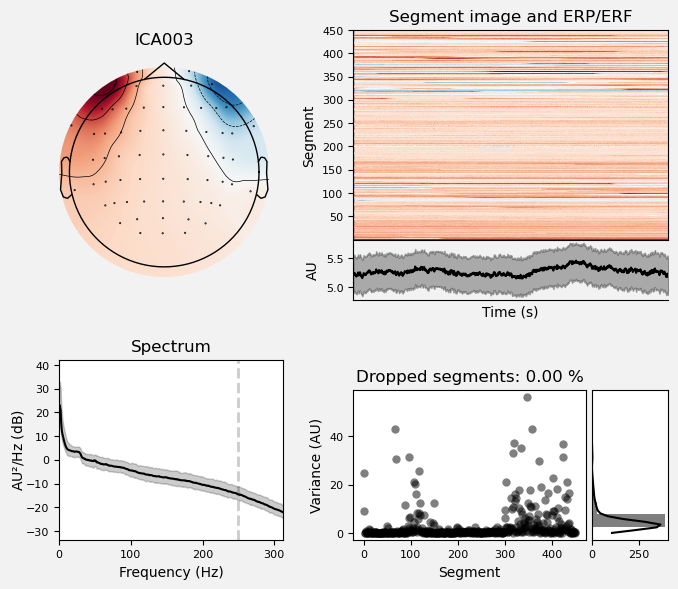

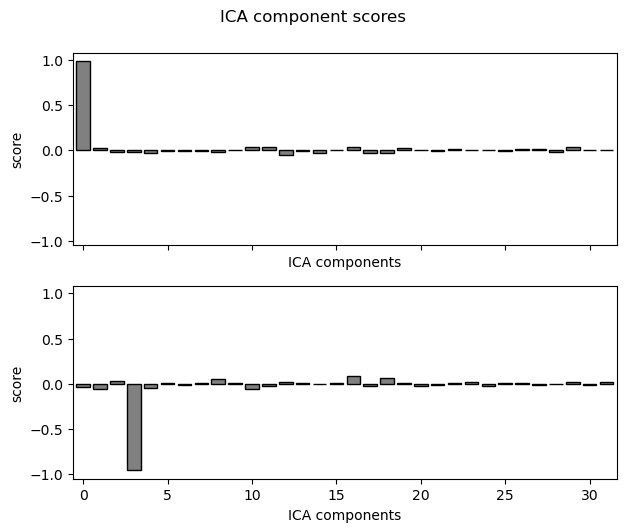

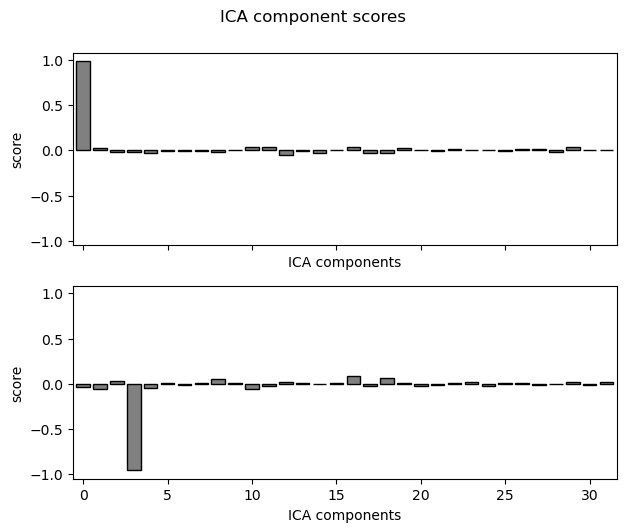

In [ ]:
# Remove blinks PCA
eog_indices, eog_scores = ica.find_bads_eog(raw_temp, ch_name=['vEOG', 'hEOG'], threshold = 0.8, measure='correlation')
ica.plot_overlay(raw_temp, exclude=eog_indices, picks="eeg")
# ica.exclude = eog_indices

ica.plot_properties(raw_temp, picks=eog_indices)
ica.plot_scores(eog_scores)

##### Check ECG PCA

Using channel ECG to identify heart beats.
Setting up band-pass filter from 8 - 16 Hz

FIR filter parameters
---------------------
Designing a two-pass forward and reverse, zero-phase, non-causal bandpass filter:
- Windowed frequency-domain design (firwin2) method
- Hann window
- Lower passband edge: 8.00
- Lower transition bandwidth: 0.50 Hz (-12 dB cutoff frequency: 7.75 Hz)
- Upper passband edge: 16.00 Hz
- Upper transition bandwidth: 0.50 Hz (-12 dB cutoff frequency: 16.25 Hz)
- Filter length: 10000 samples (10.000 s)

Number of ECG events detected : 938 (average pulse 62 / min.)
Not setting metadata
938 matching events found
No baseline correction applied
Using data from preloaded Raw for 938 events and 1001 original time points ...
3 bad epochs dropped
Applying ICA to Raw instance
    Transforming to ICA space (32 components)
    Zeroing out 3 ICA components
    Projecting back using 64 PCA components


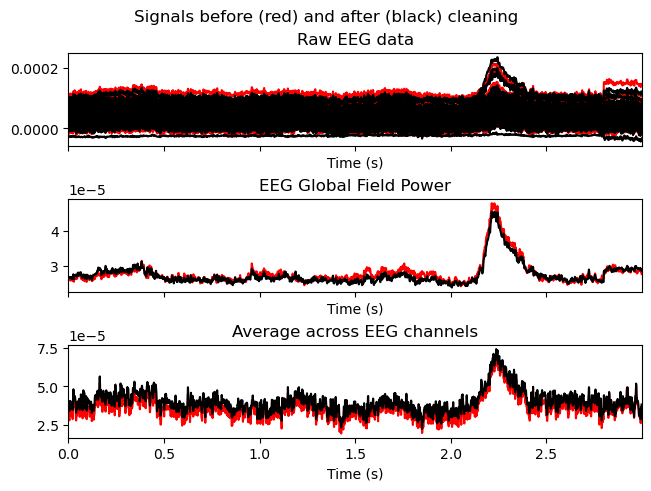

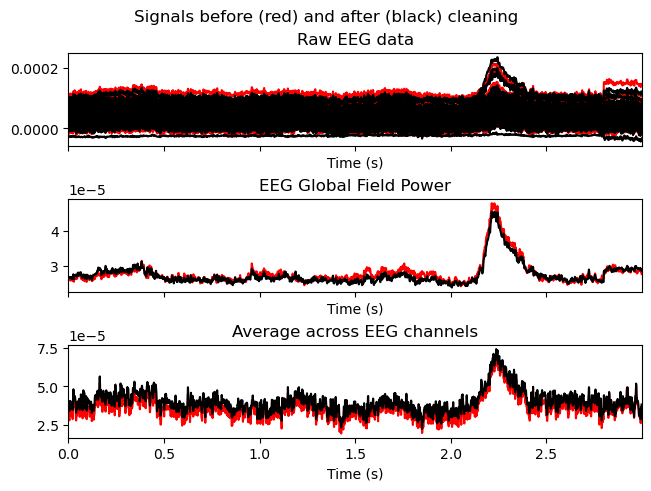

In [ ]:
#Remove heart beat PCA
ecg_indices, ecg_scores = ica.find_bads_ecg(raw_temp, ch_name='ECG',threshold = 0.8, measure='correlation')
ica.plot_overlay(raw_temp, exclude=ecg_indices, picks="eeg")
# ica.exclude = ecg_indices

# ica.plot_properties(raw_temp, picks=ecg_indices)
# ica.plot_scores(ecg_scores)

##### Check Muscle PCA

Effective window size : 2.048 (s)


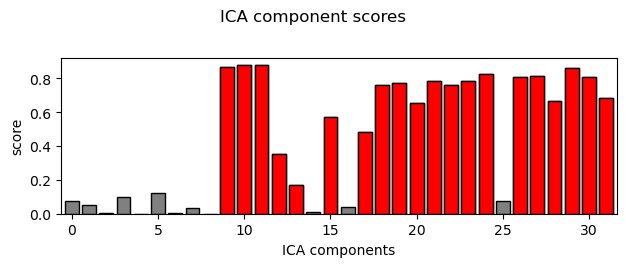

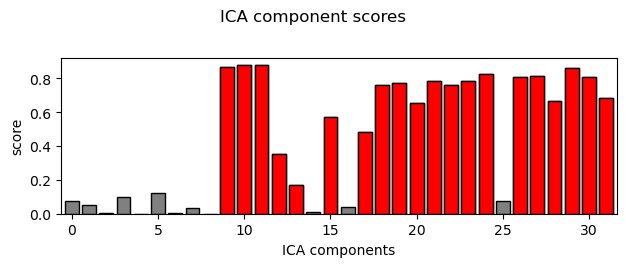

In [ ]:
#Remove muscle PCA
muscle_idx_auto, muscle_scores = ica.find_bads_muscle(raw_temp, threshold = 0.8, measure='correlation')
ica.plot_scores(muscle_scores, exclude=muscle_idx_auto, picks="eeg")
# ica.exclude = muscle_idx_auto

# ica.plot_properties(raw_temp, picks=muscle_idx_auto)
# ica.plot_scores(muscle_scores)

##### Apply ICA

In [ ]:
# ica.exclude = [..., ..., ...]
ica.exclude = eog_indices #Remove Blinks artifacts

In [ ]:
# ica.apply() changes the Raw object in-place, so let's make a copy first:
reconst_raw = raw_temp.copy()
ica.apply(reconst_raw)

Applying ICA to Raw instance
    Transforming to ICA space (32 components)
    Zeroing out 15 ICA components
    Projecting back using 64 PCA components


<RawBrainVision | 20231019_B68_stroopv1_0001.eeg, 67 x 900501 (900.5 s), ~460.4 MB, data loaded>

### After ICA EEG Analysis

In [ ]:
#Comparison between before and after ICA
reconst_raw.plot(title = 'Reconstructed')
raw_temp.plot(title = 'Raw')

In [ ]:
#Split After ICA Data into each segments

ica_firstrest = reconst_raw.copy().crop(tmin = 0, tmax = eeg_newseg1)
ica_stress = reconst_raw.copy().crop(tmin = eeg_newseg1, tmax = eeg_newseg2)
ica_secondrest = reconst_raw.copy().crop(tmin = eeg_newseg2)

### Frequency Analysis

#### Plot Frequency Bands Activity

#### PSD Analysis on EEG

Effective window size : 0.256 (s)


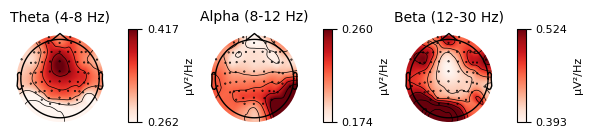

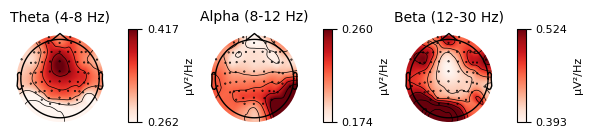

In [ ]:
#### Full Experiment Plot
eeg_psd = reconst_raw.compute_psd(method='welch',fmin=4,fmax=45).plot_topomap(bands = {'Theta (4-8 Hz)': (4, 8),'Alpha (8-12 Hz)': (8, 12), 'Beta (12-30 Hz)': (12, 30), 'Gamma (30-45 Hz)': (30, 45)}, normalize = True, ch_type='eeg')

Effective window size : 0.256 (s)


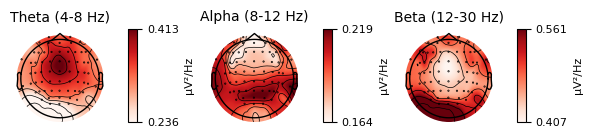

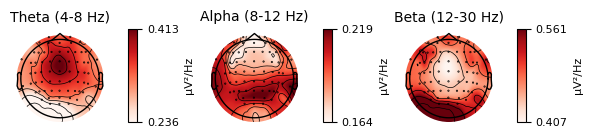

In [ ]:
#### First Rest Plot
psd_firstrest = ica_firstrest.compute_psd(method='welch',fmin=4,fmax=45).plot_topomap(bands = {'Theta (4-8 Hz)': (4, 8),'Alpha (8-12 Hz)': (8, 12), 'Beta (12-30 Hz)': (12, 30), 'Gamma (30-45 Hz)': (30, 45)}, normalize = True, ch_type='eeg')

Effective window size : 0.256 (s)


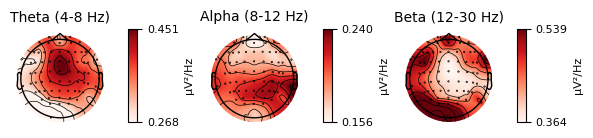

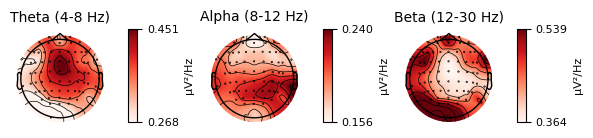

In [ ]:
#### Stress Task Plot
psd_stress = ica_stress.compute_psd(method='welch',fmin=4,fmax=45).plot_topomap(bands = {'Theta (4-8 Hz)': (4, 8),'Alpha (8-12 Hz)': (8, 12), 'Beta (12-30 Hz)': (12, 30), 'Gamma (30-45 Hz)': (30, 45)}, normalize = True, ch_type='eeg')

Effective window size : 0.256 (s)


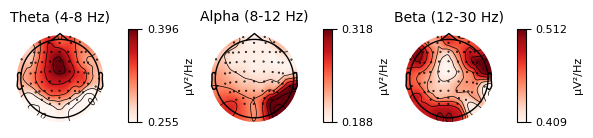

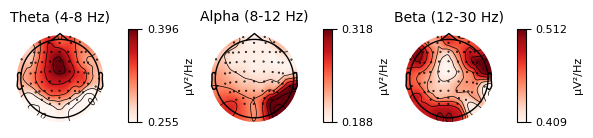

In [ ]:
#### Second Rest Plot
psd_secondrest = ica_secondrest.compute_psd(method='welch',fmin=4,fmax=45).plot_topomap(bands = {'Theta (4-8 Hz)': (4, 8),'Alpha (8-12 Hz)': (8, 12), 'Beta (12-30 Hz)': (12, 30), 'Gamma (30-45 Hz)': (30, 45)}, normalize = True, ch_type='eeg')

### Time-Frequency Analysis

In [ ]:
raw_eeg = reconst_raw.copy().pick_types(eeg=True, eog=False, ecg=False)
eeg_ch_names = raw_eeg.ch_names
eeg_data, _ = raw_eeg.get_data(picks = ['eeg'], return_times=True)

In [ ]:
# Parameters for segmentation and analysis
segment_length = 10*fs  # seconds
overlap = int(segment_length*0.9)  # seconds

#### PSD Overtime Theta Band [4 - 8 Hz]

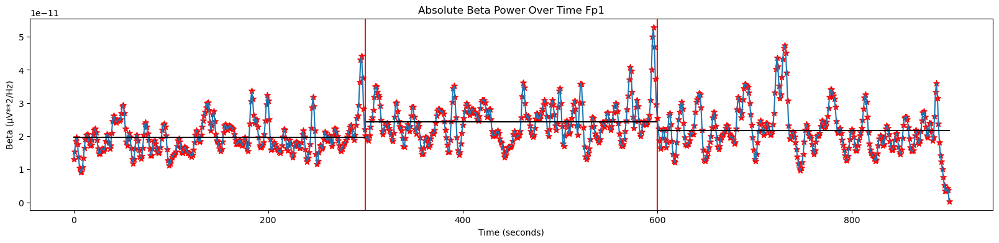

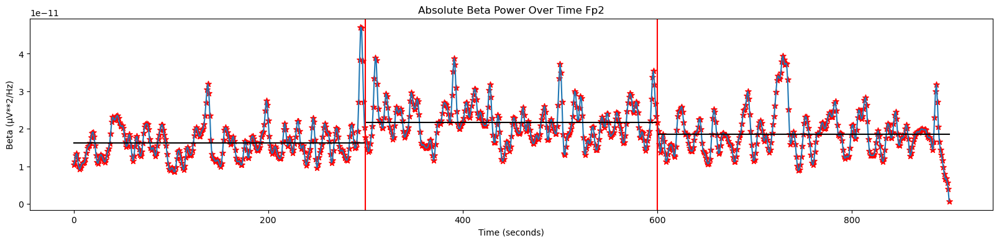

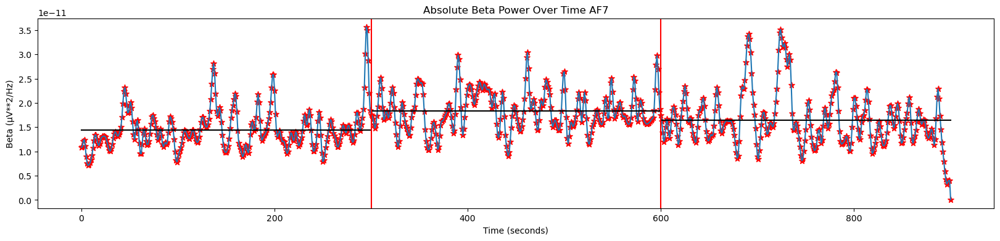

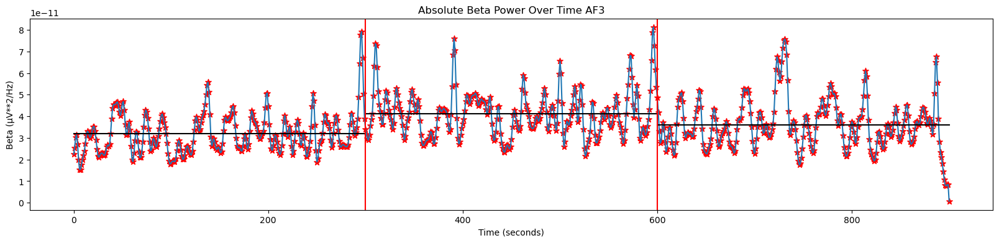

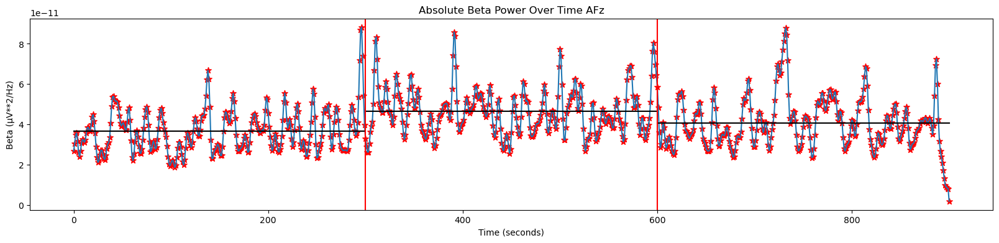

...

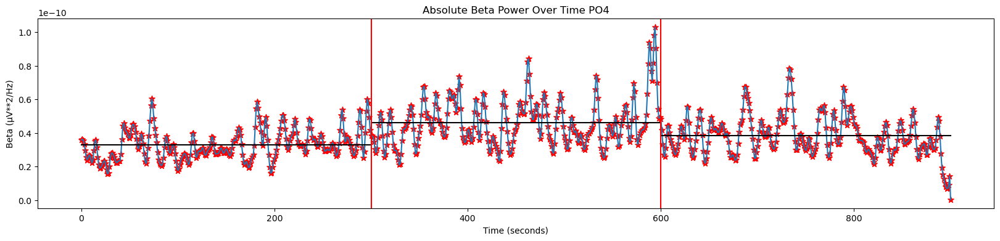

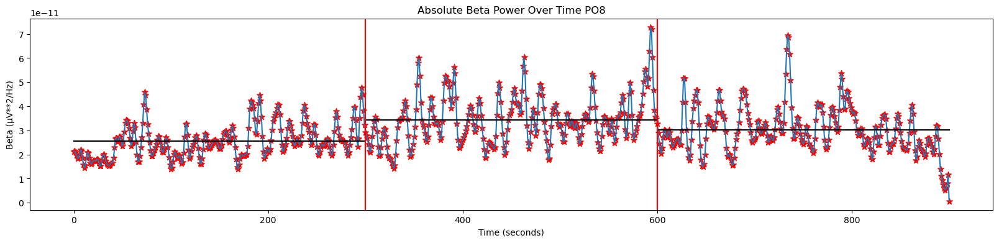

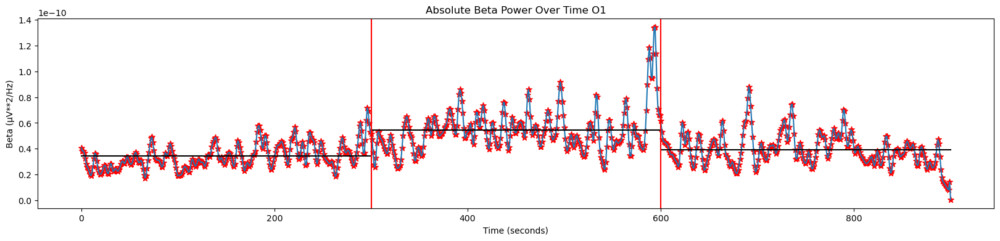

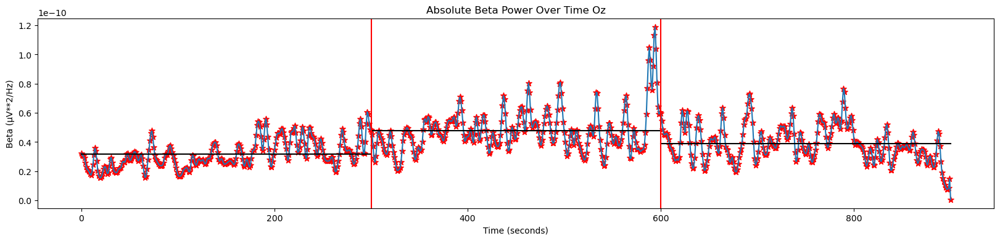

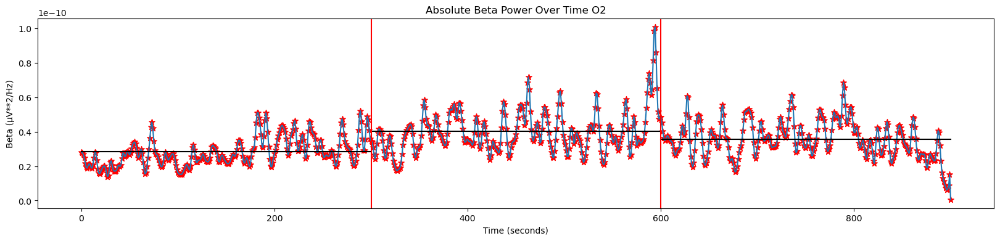

In [ ]:
# Calculate Theta Band over time
theta_over_time = []
for j in range(len(eeg_data)):
    node = eeg_data[j]
    ch_name = eeg_ch_names[j]
    for i in range(0, len(node), segment_length - overlap):
        segment = node[i:i + segment_length]

        # Compute PSD using Welch's method
        f_eeg, Pxx_eeg = sg.welch(segment, fs=fs, nperseg = 10000)

        idx_theta = np.where((4 <= f_eeg) & (f_eeg <= 8))

        # Calculate Absolute Theta power
        abs_power_theta = np.sum(np.abs(Pxx_eeg[idx_theta]))

        # Append data
        if math.isnan(abs_power_theta) == False:
            theta_over_time.append(abs_power_theta)
    
    plt.figure(figsize = (20,4))
    plt.plot(np.arange(0, len(theta_over_time)*(segment_length - overlap), segment_length - overlap)/fs, theta_over_time)
    plt.plot((0, eeg_newseg1), (np.average(theta_over_time[0:eeg_newseg1]),np.average(theta_over_time[0:eeg_newseg1])), 'k-')
    plt.plot((eeg_newseg1, eeg_newseg2), (np.average(theta_over_time[eeg_newseg1:eeg_newseg2]),np.average(theta_over_time[eeg_newseg1:eeg_newseg2])), 'k-')
    plt.plot((eeg_newseg2, eeg_newseg3), (np.average(theta_over_time[eeg_newseg2:]),np.average(theta_over_time[eeg_newseg2:])), 'k-')
    plt.scatter(np.arange(0, len(theta_over_time)*(segment_length - overlap), segment_length - overlap)/fs, theta_over_time, color = 'red', s = 50, marker ='*')
    plt.axvline(x = eeg_newseg1, color = 'r')
    plt.axvline(x = eeg_newseg2, color = 'r')
    plt.xlabel('Time (seconds)')
    plt.ylabel('Theta (μV**2/Hz)')
    plt.title('Absolute Theta Power Over Time '+ ch_name)
    plt.show()
    theta_over_time = []

#### PSD Overtime Alpha Band [8 - 12 Hz]

c:\Users\Jeremi\anaconda3\envs\mne\lib\site-packages\scipy\signal\_spectral_py.py:2014: UserWarning: nperseg = 10000 is greater than input length  = 9501, using nperseg = 9501
  warnings.warn('nperseg = {0:d} is greater than input length '
c:\Users\Jeremi\anaconda3\envs\mne\lib\site-packages\scipy\signal\_spectral_py.py:2014: UserWarning: nperseg = 10000 is greater than input length  = 8501, using nperseg = 8501
  warnings.warn('nperseg = {0:d} is greater than input length '
c:\Users\Jeremi\anaconda3\envs\mne\lib\site-packages\scipy\signal\_spectral_py.py:2014: UserWarning: nperseg = 10000 is greater than input length  = 7501, using nperseg = 7501
  warnings.warn('nperseg = {0:d} is greater than input length '
c:\Users\Jeremi\anaconda3\envs\mne\lib\site-packages\scipy\signal\_spectral_py.py:2014: UserWarning: nperseg = 10000 is greater than input length  = 6501, using nperseg = 6501
  warnings.warn('nperseg = {0:d} is greater than input length '
c:\Users\Jeremi\anaconda3\envs\mne\lib\s

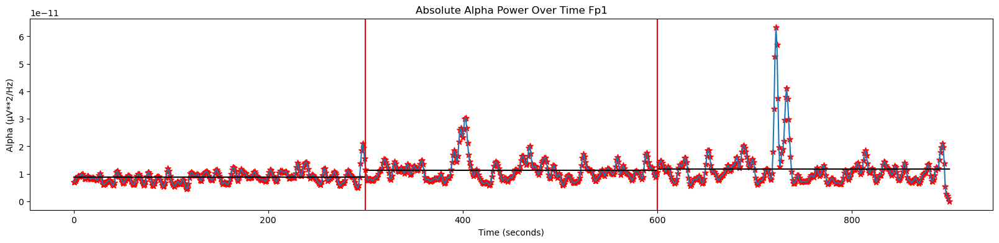

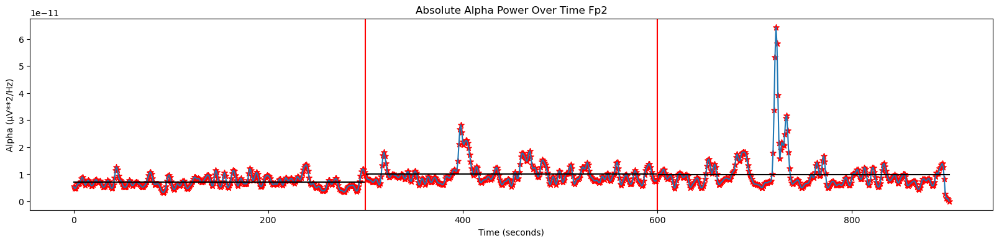

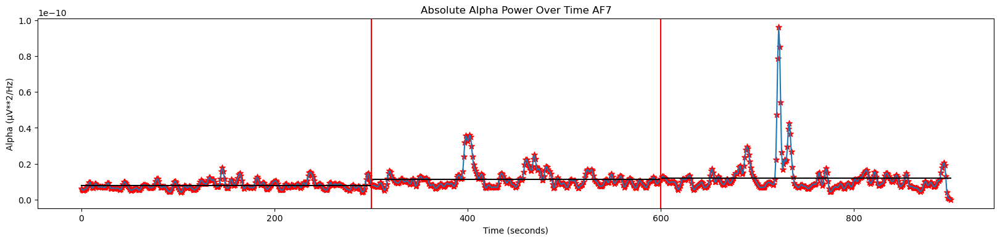

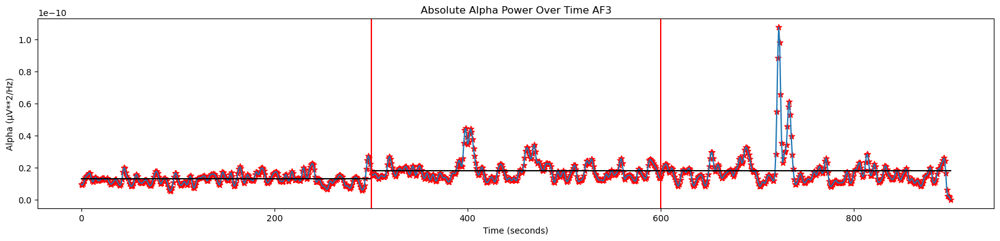

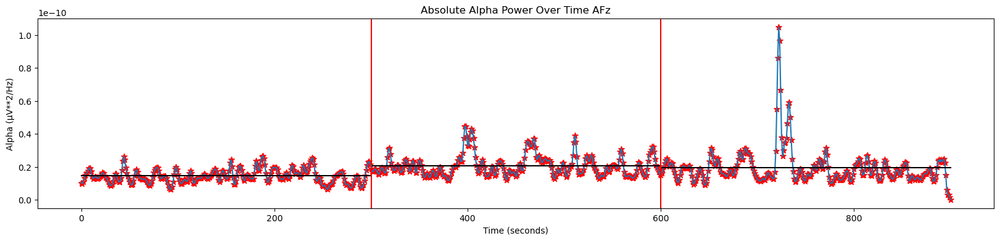

...

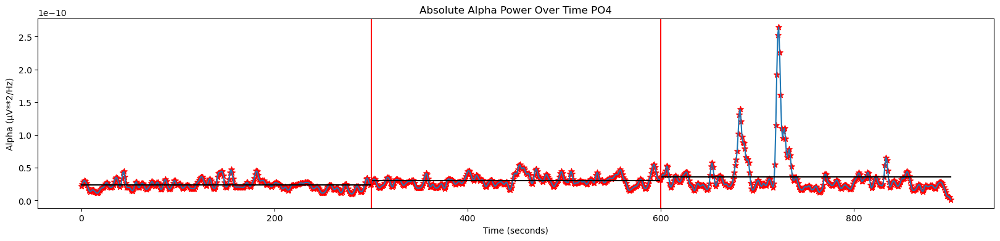

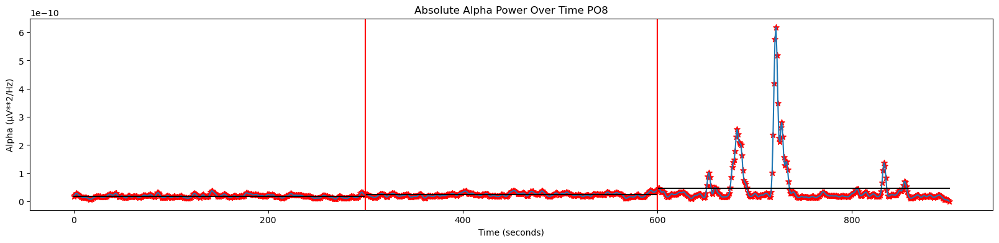

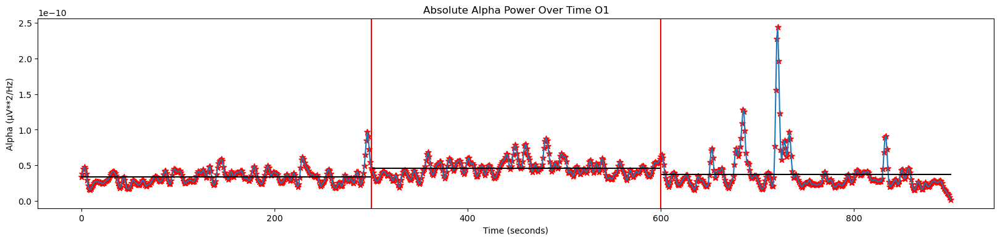

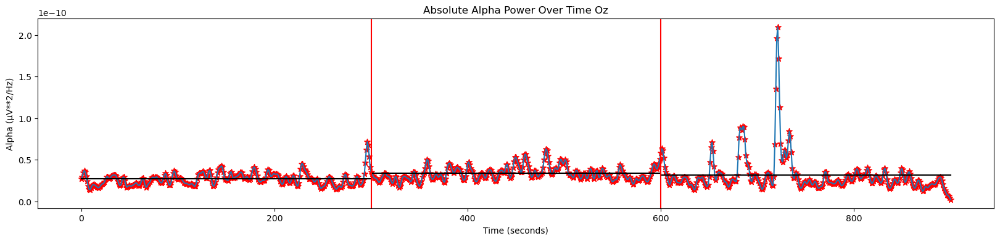

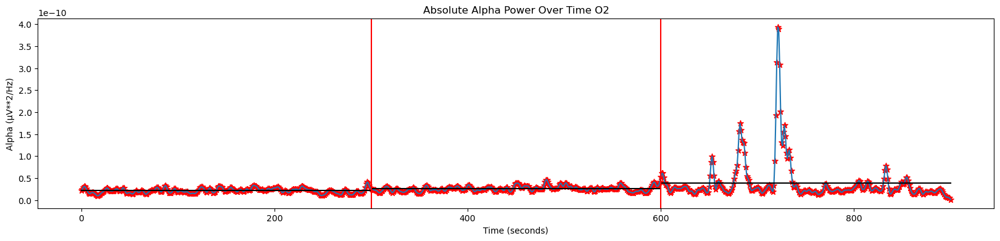

In [ ]:
# Calculate Alpha Band over time
alpha_over_time = []
for j in range(len(eeg_data)):
    node = eeg_data[j]
    ch_name = eeg_ch_names[j]
    for i in range(0, len(node), segment_length - overlap):
        segment = node[i:i + segment_length]

        # Compute PSD using Welch's method
        f_eeg, Pxx_eeg = sg.welch(segment, fs=fs, nperseg = 10000)

        idx_alpha = np.where((8 <= f_eeg) & (f_eeg <= 12))

        # Calculate Absolute Alpha power
        abs_power_alpha = np.sum(np.abs(Pxx_eeg[idx_alpha]))

        # Append data
        if math.isnan(abs_power_alpha) == False:
            alpha_over_time.append(abs_power_alpha)
    
    plt.figure(figsize = (20,4))
    plt.plot(np.arange(0, len(alpha_over_time)*(segment_length - overlap), segment_length - overlap)/fs, alpha_over_time)
    plt.plot((0, eeg_newseg1), (np.average(alpha_over_time[0:eeg_newseg1]),np.average(alpha_over_time[0:eeg_newseg1])), 'k-')
    plt.plot((eeg_newseg1, eeg_newseg2), (np.average(alpha_over_time[eeg_newseg1:eeg_newseg2]),np.average(alpha_over_time[eeg_newseg1:eeg_newseg2])), 'k-')
    plt.plot((eeg_newseg2, eeg_newseg3), (np.average(alpha_over_time[eeg_newseg2:]),np.average(alpha_over_time[eeg_newseg2:])), 'k-')
    plt.scatter(np.arange(0, len(alpha_over_time)*(segment_length - overlap), segment_length - overlap)/fs, alpha_over_time, color = 'red', s = 50, marker ='*')
    plt.axvline(x = eeg_newseg1, color = 'r')
    plt.axvline(x = eeg_newseg2, color = 'r')
    plt.xlabel('Time (seconds)')
    plt.ylabel('Alpha (μV**2/Hz)')
    plt.title('Absolute Alpha Power Over Time '+ ch_name)
    plt.show()
    alpha_over_time = []

#### PSD Overtime Beta Band [12 - 30 Hz]

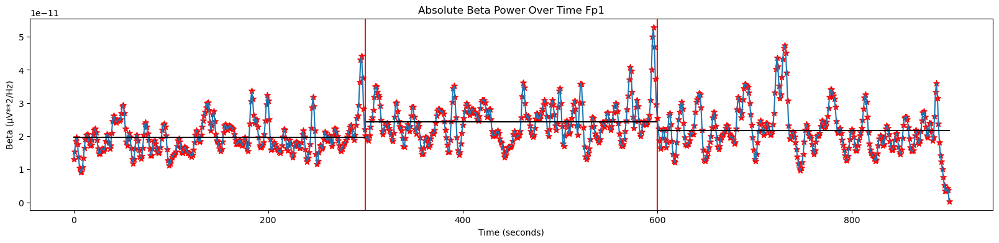

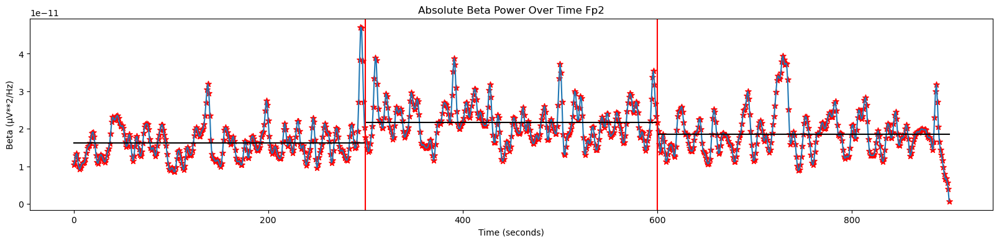

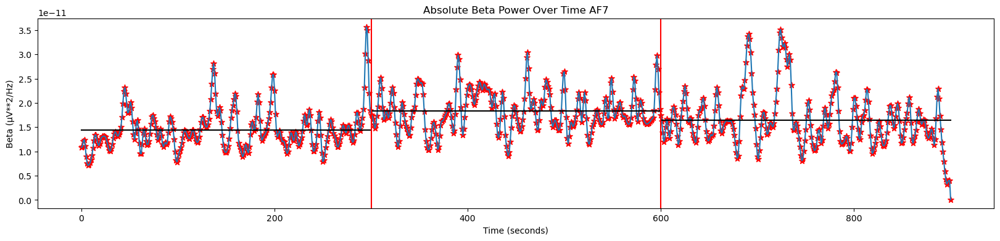

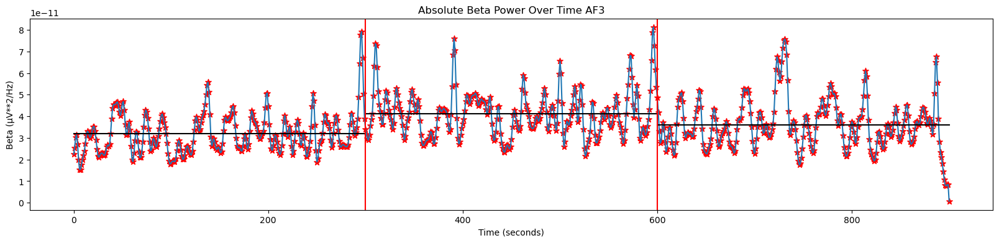

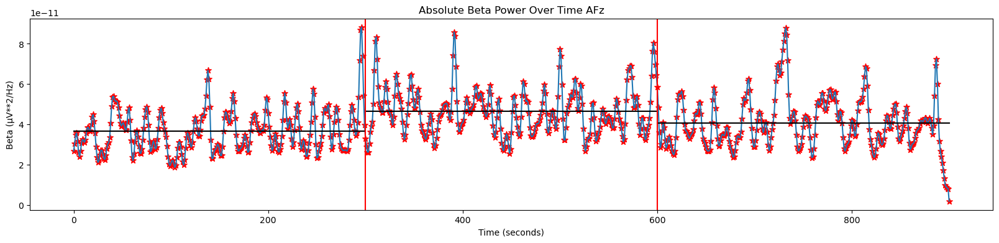

...

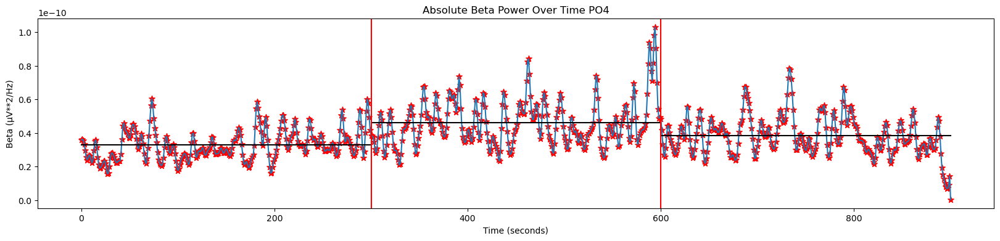

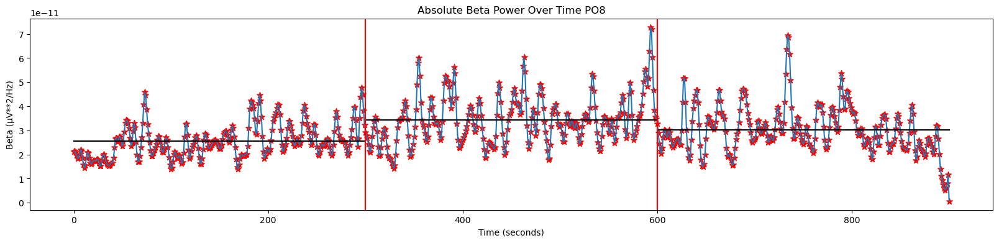

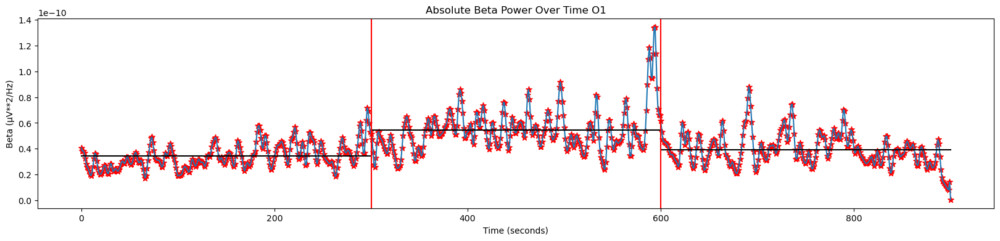

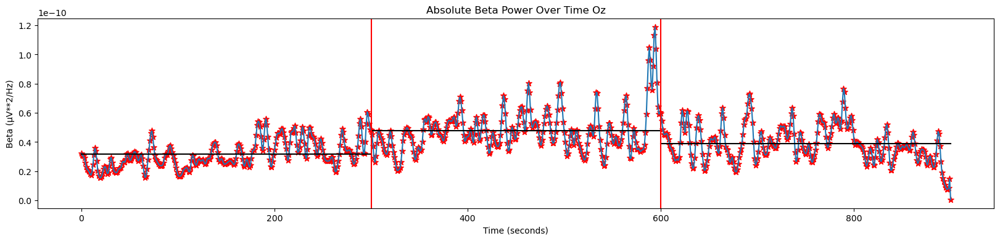

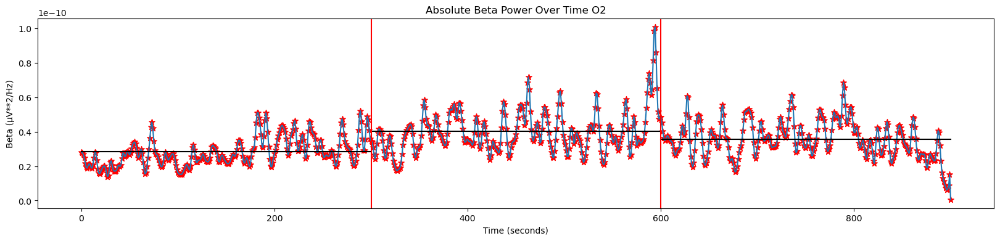

In [ ]:
# Calculate Beta Band over time
beta_over_time = []
for j in range(len(eeg_data)):
    node = eeg_data[j]
    ch_name = eeg_ch_names[j]
    for i in range(0, len(node), segment_length - overlap):
        segment = node[i:i + segment_length]

        # Compute PSD using Welch's method
        f_eeg, Pxx_eeg = sg.welch(segment, fs=fs, nperseg = 10000)

        idx_beta = np.where((12 <= f_eeg) & (f_eeg <= 30))

        # Calculate Absolute Beta power
        abs_power_beta = np.sum(np.abs(Pxx_eeg[idx_beta]))

        # Append data
        if math.isnan(abs_power_beta) == False:
            beta_over_time.append(abs_power_beta)
    
    plt.figure(figsize = (20,4))
    plt.plot(np.arange(0, len(beta_over_time)*(segment_length - overlap), segment_length - overlap)/fs, beta_over_time)
    plt.plot((0, eeg_newseg1), (np.average(beta_over_time[0:eeg_newseg1]),np.average(beta_over_time[0:eeg_newseg1])), 'k-')
    plt.plot((eeg_newseg1, eeg_newseg2), (np.average(beta_over_time[eeg_newseg1:eeg_newseg2]),np.average(beta_over_time[eeg_newseg1:eeg_newseg2])), 'k-')
    plt.plot((eeg_newseg2, eeg_newseg3), (np.average(beta_over_time[eeg_newseg2:]),np.average(beta_over_time[eeg_newseg2:])), 'k-')
    plt.scatter(np.arange(0, len(beta_over_time)*(segment_length - overlap), segment_length - overlap)/fs, beta_over_time, color = 'red', s = 50, marker ='*')
    plt.axvline(x = eeg_newseg1, color = 'r')
    plt.axvline(x = eeg_newseg2, color = 'r')
    plt.xlabel('Time (seconds)')
    plt.ylabel('Beta (μV**2/Hz)')
    plt.title('Absolute Beta Power Over Time '+ ch_name)
    plt.show()
    beta_over_time = []

#### PSD Overtime Gamma Band [30 - 45 Hz]

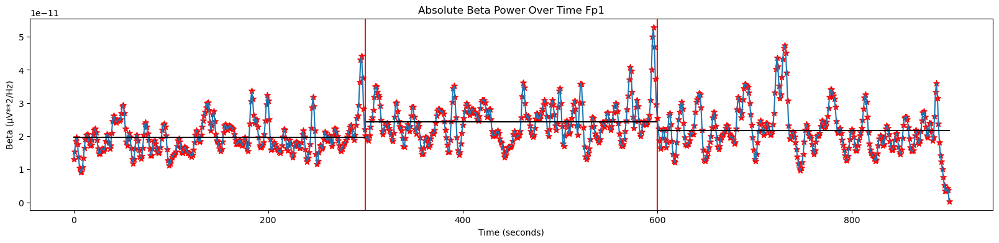

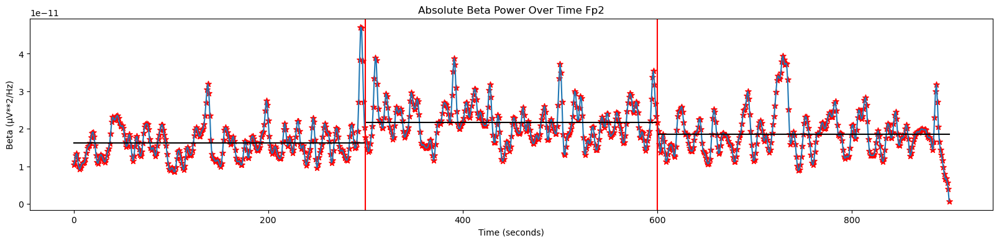

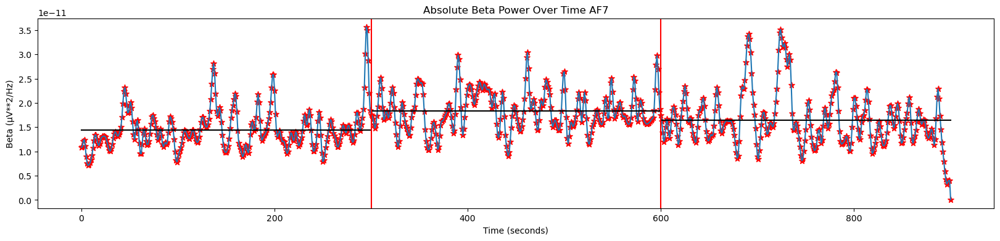

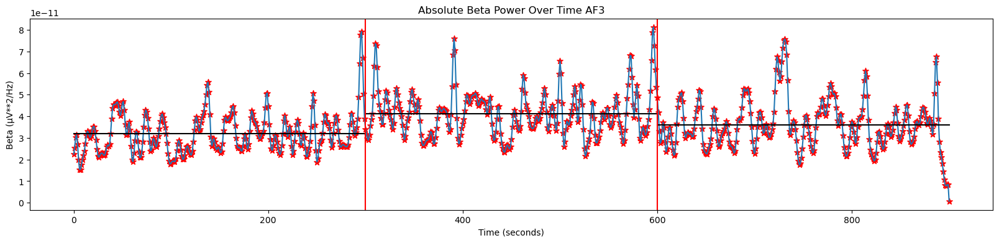

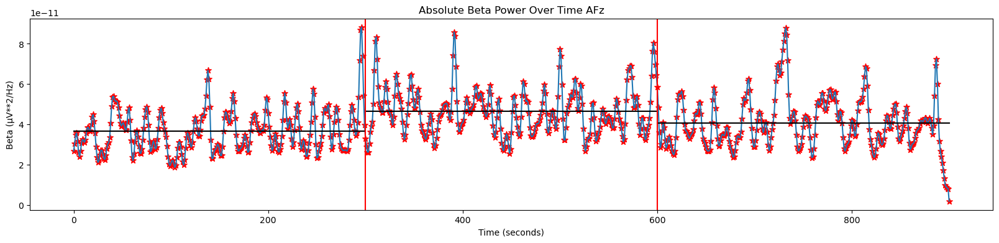

...

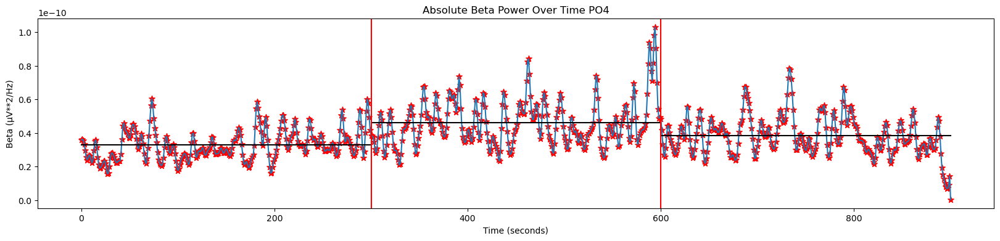

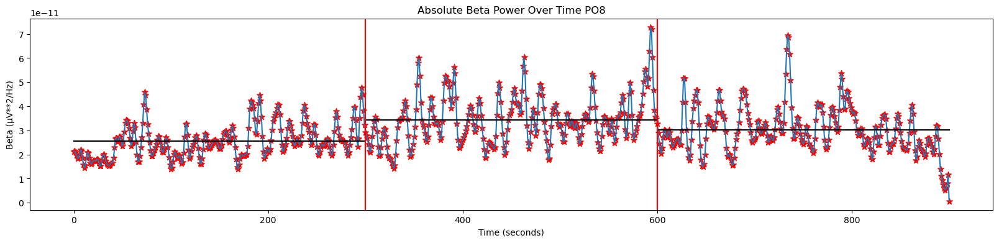

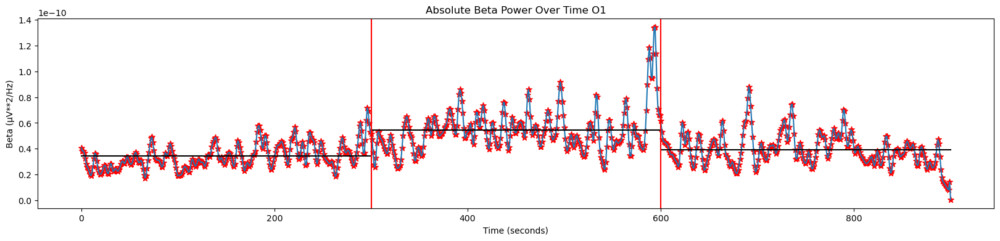

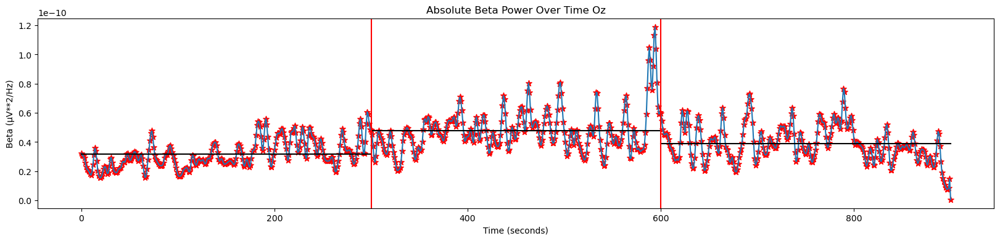

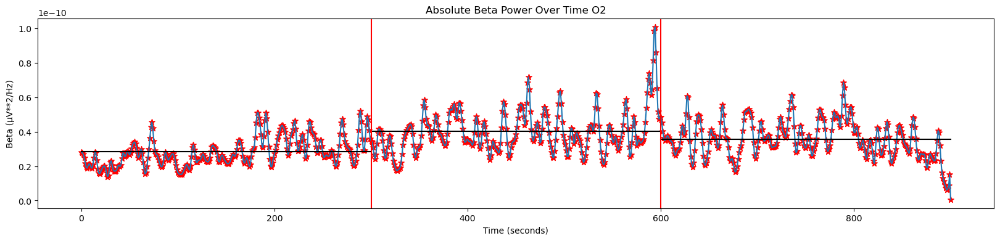

In [ ]:
# Calculate Gamma Band over time
gamma_over_time = []
for j in range(len(eeg_data)):
    node = eeg_data[j]
    ch_name = eeg_ch_names[j]
    for i in range(0, len(node), segment_length - overlap):
        segment = node[i:i + segment_length]

        # Compute PSD using Welch's method
        f_eeg, Pxx_eeg = sg.welch(segment, fs=fs, nperseg = 10000)

        idx_gamma = np.where((30 <= f_eeg) & (f_eeg <= 45))

        # Calculate Absolute Gamma power
        abs_power_gamma = np.sum(np.abs(Pxx_eeg[idx_gamma]))

        # Append data
        if math.isnan(abs_power_gamma) == False:
            gamma_over_time.append(abs_power_gamma)
    
    plt.figure(figsize = (20,4))
    plt.plot(np.arange(0, len(gamma_over_time)*(segment_length - overlap), segment_length - overlap)/fs, gamma_over_time)
    plt.plot((0, eeg_newseg1), (np.average(gamma_over_time[0:eeg_newseg1]),np.average(gamma_over_time[0:eeg_newseg1])), 'k-')
    plt.plot((eeg_newseg1, eeg_newseg2), (np.average(gamma_over_time[eeg_newseg1:eeg_newseg2]),np.average(gamma_over_time[eeg_newseg1:eeg_newseg2])), 'k-')
    plt.plot((eeg_newseg2, eeg_newseg3), (np.average(gamma_over_time[eeg_newseg2:]),np.average(gamma_over_time[eeg_newseg2:])), 'k-')
    plt.scatter(np.arange(0, len(gamma_over_time)*(segment_length - overlap), segment_length - overlap)/fs, gamma_over_time, color = 'red', s = 50, marker ='*')
    plt.axvline(x = eeg_newseg1, color = 'r')
    plt.axvline(x = eeg_newseg2, color = 'r')
    plt.xlabel('Time (seconds)')
    plt.ylabel('Gamma (μV**2/Hz)')
    plt.title('Absolute Gamma Power Over Time '+ ch_name)
    plt.show()
    gamma_over_time = []